In [3]:
from simulations.snr_ber_average_ibo import Result #pklを使うのに必要
import numpy as np
import matplotlib.pyplot as plt
import pickle
%matplotlib inline

results = []
pkl_paths = [
    '../results/snr_ber_average_ibo/2020/11/18/15_54_23/snr_ber_average_ibo.pkl',
    '../results/snr_ber_average_ibo/2020/11/18/15_54_28/snr_ber_average_ibo.pkl',
    '../results/snr_ber_average_ibo/2020/11/18/16_07_44/snr_ber_average_ibo.pkl',
    '../results/snr_ber_average_ibo/2020/11/18/16_07_46/snr_ber_average_ibo.pkl',
]

for pkl_path in pkl_paths:
    with open(pkl_path, 'rb') as f:
        result = pickle.load(f)
        results.append(result)

# 結合させる
errors_list = []
losss_list = []
val_losss_list = []

for result in results:
    errors_list.append(result.errors)
    losss_list.append(result.losss)
    val_losss_list.append(result.val_losss)

errors = np.concatenate(errors_list, 2)
losss = np.concatenate(losss_list, 2)
val_losss = np.concatenate(val_losss_list, 2)

params = results[0].params

snrs_db = np.linspace(params['SNR_MIN'], params['SNR_MAX'], params['SNR_NUM'])

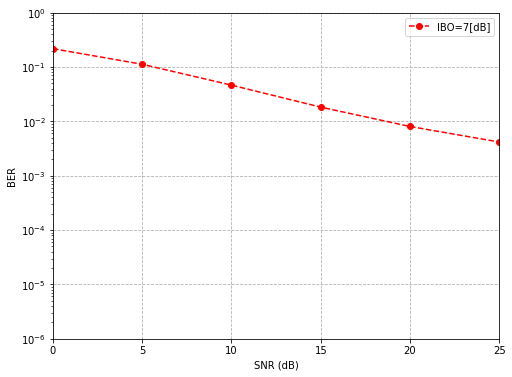

In [4]:
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111)
ax.set_xlabel("SNR (dB)")
ax.set_ylabel("BER")
ax.set_yscale('log')
ax.set_xlim(params['SNR_MIN'], params['SNR_MAX'])
y_min = pow(10, 0)
y_max = pow(10, -6)
ax.set_ylim(y_max, y_min)
ax.set_xlim(params['SNR_MIN'], params['SNR_MAX'])
ax.grid(linestyle='--')

train_data = params['n'] - (params['n'] * params['trainingRatio'])
n_ave = train_data * params['SNR_AVERAGE'] * len(results)

color_list = ["r", "g", "b", "c", "m", "y", "k", "w"]
for IBO_index, IBO_db in enumerate(params['IBO_dB']):
    errors_sum = np.sum(errors[IBO_index], axis=1)
    bers = errors_sum / n_ave
    ax.plot(snrs_db, bers, color=color_list[IBO_index], marker='o', linestyle='--', label="IBO=%d[dB]" % IBO_db)

ax.legend()
plt.show()

error 914
h_si: [[0.42616812+0.04323109j]]
h_si_abs: [[0.42835522]]
h_s: [[0.01031397-0.07201438j]]
h_s_abs: [[0.07274922]]


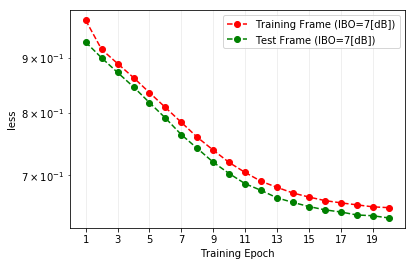

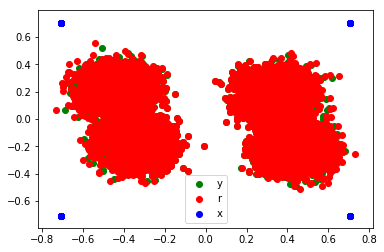

In [37]:
target_index = 13
target_sigma = 4

nn_model = results[0].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()


plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()

error 297
h_si: [[-0.88168271+0.10569093j]]
h_si_abs: [[0.88799492]]
h_s: [[0.06509457-0.13098629j]]
h_s_abs: [[0.14626931]]


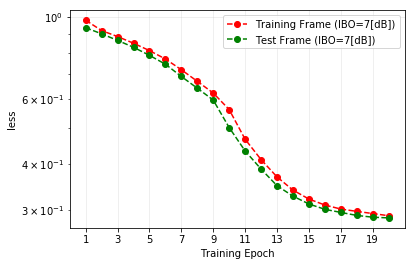

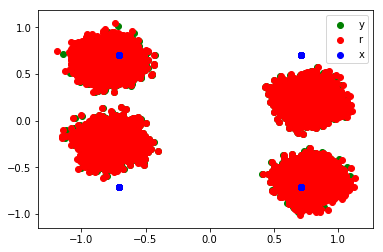

In [36]:
target_index = 16
target_sigma = 4

nn_model = results[0].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()

plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()

error 0
h_si: [[-0.50080367+1.2118086j]]
h_si_abs: [[1.31121486]]
h_s: [[-0.36051031-0.43997424j]]
h_s_abs: [[0.56881017]]


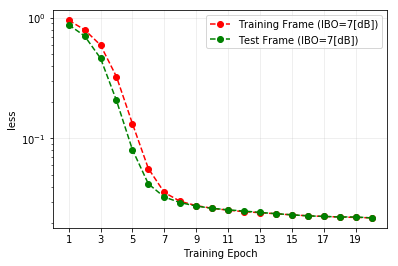

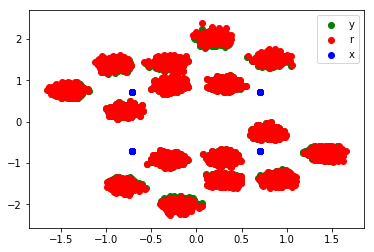

In [35]:
target_index = 10
target_sigma = 4

nn_model = results[0].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()

plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()

error 0
h_si: [[1.0455539+0.53807143j]]
h_si_abs: [[1.17588427]]
h_s: [[0.55492666+0.51517734j]]
h_s_abs: [[0.75719963]]


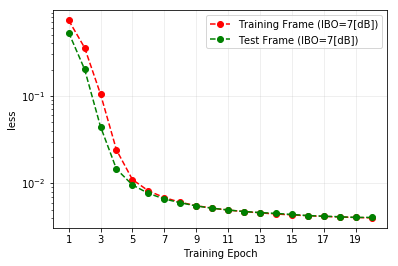

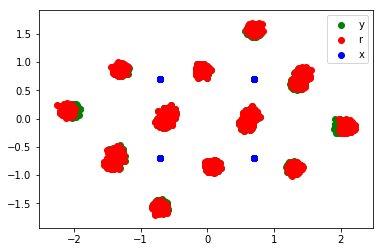

In [34]:
target_index = 1
target_sigma = 5

nn_model = results[0].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()

plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()

error 0
h_si: [[0.52606831-0.00065858j]]
h_si_abs: [[0.52606873]]
h_s: [[-0.51394557+1.26147347j]]
h_s_abs: [[1.36215101]]


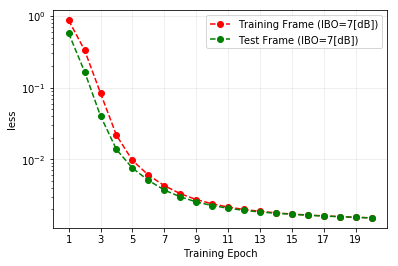

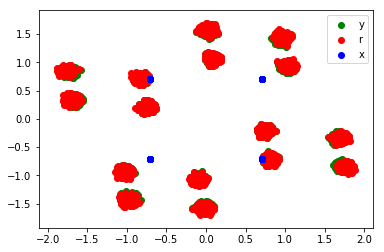

In [33]:
target_index = 0
target_sigma = 5

nn_model = results[0].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()

plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()

In [41]:
system_models = []
for result in results:
    for trials_index in range(params['SNR_AVERAGE']):
        system_models.append(result.nn_models[0][5][trials_index].system_model)

h_s_array = np.zeros(len(system_models), dtype=np.complex)
h_si_array = np.zeros(len(system_models), dtype=np.complex)

for i, system_model in enumerate(system_models):
    h_s_array[i] = system_model.h_s
    h_si_array[i] = system_model.h_si

print('h_s_var:', np.var(h_s_array))
print('h_si_var:', np.var(h_si_array))

h_s_var: 0.9497549061622662
h_si_var: 1.0040559257496455


error 544
h_si: [[0.29611541-1.51259269j]]
h_si_abs: [[1.54130496]]
h_s: [[-0.1237287+0.02840321j]]
h_s_abs: [[0.12694697]]


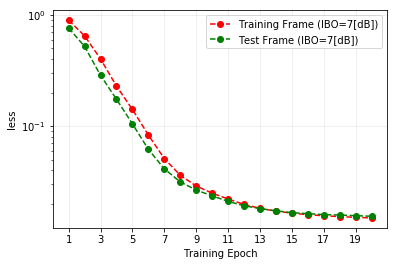

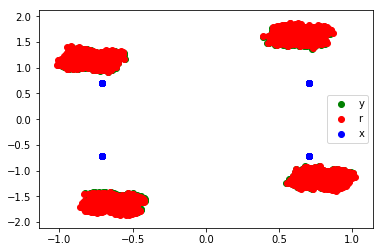

In [49]:
target_index = 3
target_sigma = 5

nn_model = results[3].nn_models[0][target_sigma][target_index]
system_model = nn_model.system_model
print('error', nn_model.error)
print('h_si:', system_model.h_si)
print('h_si_abs:', np.abs(system_model.h_si))
print('h_s:', system_model.h_s)
print('h_s_abs:', np.abs(system_model.h_s))

plt.figure()
loss = losss[0][target_sigma][target_index,:]
val_loss = val_losss[0][target_sigma][target_index,:]
plt.plot(np.arange(1, len(loss) + 1), loss, color=color_list[IBO_index], marker='o', linestyle='--',
            label='Training Frame (IBO=%d[dB])' % IBO_db)
plt.plot(np.arange(1, len(val_loss) + 1), val_loss, color=color_list[IBO_index + len(params['IBO_dB'])],
            marker='o', linestyle='--', label='Test Frame (IBO=%d[dB])' % IBO_db)

plt.ylabel('less')
plt.yscale('log')
plt.xlabel('Training Epoch')
plt.legend()
plt.grid(which='major', alpha=0.25)
plt.xlim([0, params['nEpochs'] + 1])
plt.xticks(range(1, params['nEpochs'], 2))
plt.show()

plt.figure()
plt.scatter(system_model.y.real, system_model.y.imag, color="g", label="y")
plt.scatter(system_model.r.real, system_model.r.imag, color="red", label="r")
plt.scatter(system_model.x.real, system_model.x.imag, color="b", label="x")
plt.legend()
plt.show()